# Animal Crossing vs Doom - Suggested solution

**Author**: Thien Tran

**Last update**: 21 August 2021

This is the Suggested solution for the MLDA Academics recruitment's Optional task. See the original task [here](https://github.com/gau-nernst/mlda-acad-recruitment).

This notebook is designed to run on Google Colab.

Change runtime type to GPU if you haven't done so.

View GPU info with `nvidia-smi`. If you are lucky, you will get Tesla T4 from Google Colab. This is the best GPU available here.

In [1]:
!nvidia-smi

Sat Aug 21 12:35:02 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.57.02    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   66C    P8    11W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Download the dataset

Use Kaggle API to download the dataset. See [here](https://www.kaggle.com/docs/api) for more information

- Generate and download Kaggle API key from your Kaggle account
- Upload the key to Colab
- Move it to the appropriate folder

In [5]:
!mkdir ../root/.kaggle/
!mv "./kaggle.json" "../root/.kaggle/"

mkdir: cannot create directory ‘../root/.kaggle/’: File exists


In [6]:
!kaggle datasets download -d andrewmvd/doom-crossing

 99% 986M/997M [00:18<00:00, 57.8MB/s]
100% 997M/997M [00:18<00:00, 55.9MB/s]


In [7]:
!unzip doom-crossing.zip -d dataset > /dev/null

## Visualize the dataset

Folder structure

```bash
|-- animal_crossing
|   |-- img1.jpg
|   |-- ...
|-- doom
|   |-- img2.jpg
|   |-- ...
```

In [8]:
from torchvision.datasets import ImageFolder

dataset = ImageFolder("dataset")
class_to_idx = dataset.class_to_idx
idx_to_class = {v:k for k,v in class_to_idx.items()}

class_to_idx

{'animal_crossing': 0, 'doom': 1}

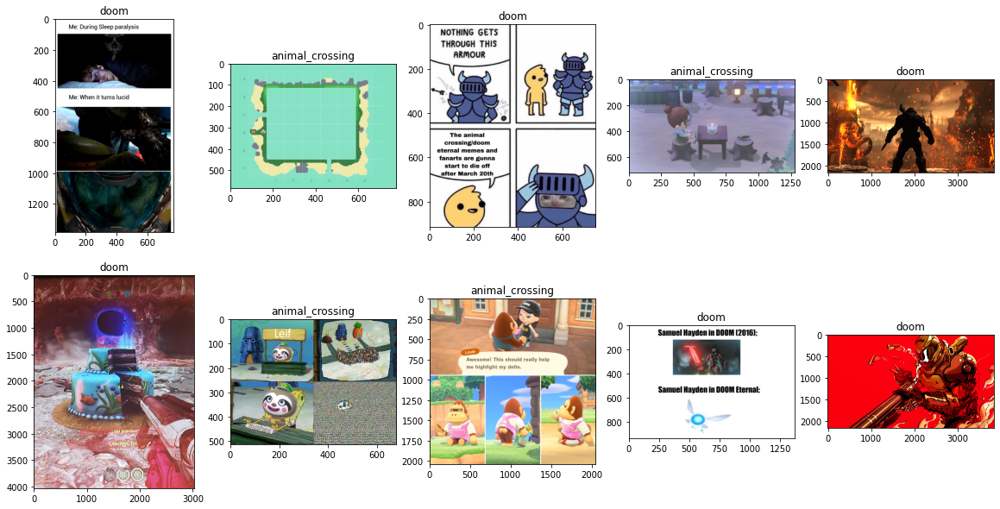

In [9]:
import random
import matplotlib.pyplot as plt

indices = random.sample(range(len(dataset)), 10)
plt.figure(figsize=(20,10))

for i, idx in enumerate(indices):
    img, label = dataset[idx]
    
    plt.subplot(2,5,i+1)
    plt.imshow(img)
    plt.title(idx_to_class[label])

## Train - Validation split

Do 80-20 split for train and validation

**Note**: Some submissions do train-validation-test split. This is a good practice to have 3 separate splits. However, for a simple task like this, it is fine to only do train-validation split.

Purpose of each split:

- **Train**: used for training. Your model will learn from this set
- **Validation**: used for evaluation during training. This includes testing for overfitting, hyperparameter tuning. Your model will **not learn** from this set, but you will use this set **many times** during training.
- **Test**: used for final evaluation. This will only be used **once**, after you have trained and tuned your models (using the train and validation set). In research, evaluation metrics on this set are used to results reporting.

There are special requirements to prepare a good train-validation or train-validation-test split. You will learn more about this later.

Another reason it's a good idea to have a separate validation and test splits is that you can **overfit the validation set**. If you do heavy tuning on the validation set, you have implicitly "overfitted" the validation set. Thus running evaluation on another set (test set) will prevent this problem.

There are other approaches to prevent this problem also, such as **cross-validation**.

In [10]:
from torch.utils.data import random_split

val_size = len(dataset) // 5
train_size = len(dataset) - val_size

train_ds, val_ds = random_split(dataset, (train_size, val_size))

print("Train size:", len(train_ds))
print("Validation size:", len(val_ds))

Train size: 1278
Validation size: 319


## Define Dataset

I will be using PyTorch and PyTorch Lightning to do this task. This is just a personal preference

You can read more about them here

- PyTorch: https://pytorch.org/
- PyTorch Lightning: https://www.pytorchlightning.ai/

To understand more about PyTorch Dataset, read [here](https://pytorch.org/tutorials/beginner/basics/data_tutorial.html)

### Define data transformations

- Train set: resize + augmentation
- Validation / test set: resize

There are many benefits of data augmentation:

- Neural networks are notorious for overfitting. Data augmentation introduces more **variations** in the training set as a form of **regularization**
- For a small dataset like this, augmentation is equivalent to **generating more samples** for training
- Augmentation can be used to **simulate** certain behaviors or data characteristics that are not present or lacking in the training set

Data augmentation is also an interesting topic for research. There are many modern advanced techniques, such as CutMix, Random Erasing, Copy Paste. Again, there are special considerations for augmentation also. You will learn more about this.

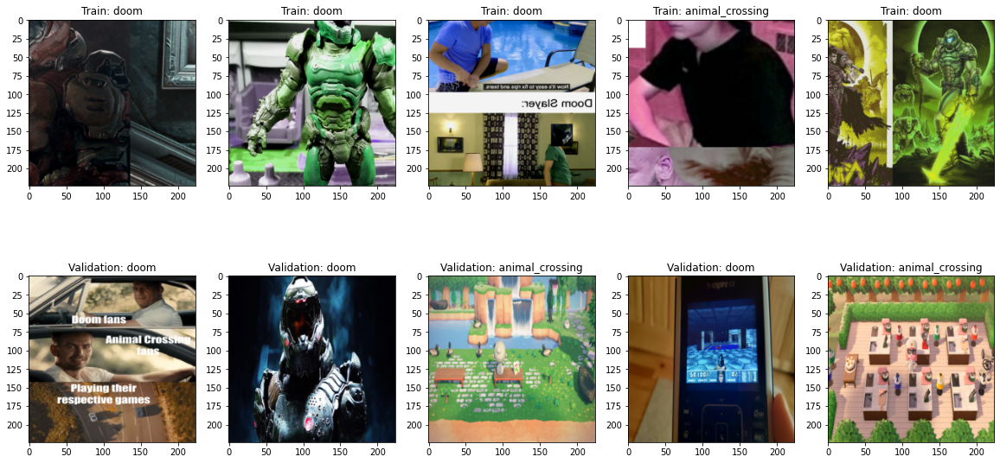

In [11]:
import torchvision.transforms as T
from copy import deepcopy

# define transformations for training set
train_transforms = T.Compose([
    T.RandomResizedCrop((224,224)), 
    T.RandomHorizontalFlip(), 
    T.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
    T.ToTensor()
])

# define transformations for validation set
val_transforms = T.Compose([
    T.Resize((224,224)),
    T.ToTensor()
])

val_ds = deepcopy(val_ds)

train_ds.dataset.transform = train_transforms
val_ds.dataset.transform = val_transforms

# visualize the images after transformations
plt.figure(figsize=(20,10))
for i in range(5):
    img, label = train_ds[i]
    
    plt.subplot(2,5,i+1)
    plt.imshow(img.numpy().transpose(1,2,0))
    plt.title(f"Train: {idx_to_class[label]}")

    img, label = val_ds[i]
    
    plt.subplot(2,5,i+6)
    plt.imshow(img.numpy().transpose(1,2,0))
    plt.title(f"Validation: {idx_to_class[label]}")

**Note**: for transfer learning, it is important that your data pre-processing (transformation and normalization) is **the same** as what the model was previously trained with. You have to look at where you get your pre-trained model to find out the config they used. 

I actually ignore normalization with ImageNet statistics, as recommended by `torchvision`. For this simple example, it won't make a significant difference.

## Define the model

I will use PyTorch Lightning to define my model. It is a wrapper around PyTorch to help you build and experiment with machine learning models faster.

In [12]:
!pip install -U pytorch-lightning -q

     |████████████████████████████████| 916 kB 8.3 MB/s 
     |████████████████████████████████| 272 kB 74.5 MB/s 
     |████████████████████████████████| 636 kB 55.6 MB/s 
     |████████████████████████████████| 829 kB 61.3 MB/s 
     |████████████████████████████████| 118 kB 66.8 MB/s 
     |████████████████████████████████| 1.3 MB 56.9 MB/s 
     |████████████████████████████████| 294 kB 72.8 MB/s 
     |████████████████████████████████| 142 kB 67.2 MB/s 


In [13]:
import pytorch_lightning as pl                  # import pytorch lightning
from torchvision.models import resnet18         # import ResNet18
import torch
from torch import nn
import torch.nn.functional as F

class ImageClassifier(pl.LightningModule):
    def __init__(self, num_classes, loss_fn, learning_rate=1e-2):
        super().__init__()
        self.backbone = resnet18(pretrained=True)                       # create a ResNet18 model with pre-trained weights
        fc_in_features = self.backbone.fc.in_features
        self.backbone.fc = nn.Linear(fc_in_features, num_classes)       # replace the last Linear/Dense layer with our number of classes

        self.loss_fn = loss_fn
        self.learning_rate = learning_rate

    # this is used for inference
    def forward(self, img):
        logits = self.backbone(img)
        return logits

    # model is trained here
    def training_step(self, batch, batch_idx):
        img, label = batch
        logits = self.backbone(img)                 # forward pass through the model
        loss = self.loss_fn(logits, label)       # apply cross entropy loss

        self.log("train/loss", loss)
        return loss

    # model is evaluated with validation set here
    def validation_step(self, batch, batch_idx):
        img, label = batch
        logits = self.backbone(img)
        loss = self.loss_fn(logits, label)

        preds = torch.argmax(logits, dim=-1)            # prediction is the index with highest output
        acc = (label == preds).sum() / label.numel()    # calculate accuracy
        
        self.log("val/loss", loss)
        self.log("val/acc", acc)

    # define the optimizer and learning rate scheduler
    def configure_optimizers(self):
        optimizer = torch.optim.SGD(self.parameters(), lr=self.learning_rate)
        scheduler = torch.optim.lr_scheduler.OneCycleLR(optimizer, max_lr=self.learning_rate, steps_per_epoch=len(self.train_dataloader()), epochs=self.trainer.max_epochs)
        return {
            "optimizer": optimizer,
            "lr_scheduler": {
                'scheduler': scheduler,
                'interval': 'step'
            }
        }

model = ImageClassifier(2, nn.CrossEntropyLoss())

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

In the Lightning Module above, I have defined 5 methods:

- `__init__()`: this is the class constructor. We will define our model here, which is a pre-trained ResNet18 from torchvision
- `forward()`: this is the forward pass of the model to get output probabilities
- `training_step()`: calculate the loss here during training
- `validation_step()`: same as training step. In addition, we will also calculate the accuracy here
- `configure_optimizers()`: define the optimizer and learning rate scheduler here

See Lightning documentation [here](https://pytorch-lightning.readthedocs.io/en/latest/common/lightning_module.html) for more information.

### General considerations

**Model choice** You can choose any CNN models from this task. For such a small dataset, a small model, such as ResNet18, should suffice. MobileNetv2 is also a good choice.

**Number of outputs** Since we only have 2 classes, we can either treat this as a **binary classification**, which only needs 1 output neuron, or **multi-class classification**, which needs 2 output neurons. Either approach should be fine to classify 2 classes, but later you will see having 2 output neurons is more suitable.

**Loss function** If you use 1 output neuron, your loss function should be **binary cross-entropy loss**. If you use 2 output neurons, your loss should be **cross-entropy loss**. *Question to think about: Can you use mean squared error loss, or other types of regression loss?*

**Optimizer** Popular optimizers are SGD, Adam, and RMSprop. Any optimizer should work fine here. From my personal experience, SGD usually works better for transfer learning.

### Transfer learning considerations

When we create a new classification head, that layer is initialized randomly, but the rest of the model has already been trained. Thus we need to **warm up** the newly created layer, so that we won't destroy the learned weights from the rest of the model.

There are several approaches to do this. One way is to **train only the classification head**, while freezing the rest of the model, for a few epochs, then train the whole model. This is a common approach I saw in the submissions.

Another way is to use a learning rate scheduler to **slowly increase learning rate** from a very small value to a desired value. This ensures the model learns slowly at first, to warm up the new layers, before taking more aggressive steps to update the weights. This is the method I use when I specify learning rate scheduler `OneCycleLR` above.

## Training

### Create a trainer

We will specify training configuration here.

Read Trainer documentation [here](https://pytorch-lightning.readthedocs.io/en/latest/common/trainer.html) for more information.

In [14]:
from pytorch_lightning.callbacks import LearningRateMonitor

trainer = pl.Trainer(
    gpus=1,                             # use 1 GPU
    precision=16,                       # use mixed-precision training
    max_epochs=10,                      # train for 10 epochs
    log_every_n_steps=5,
    callbacks=[LearningRateMonitor()]
)

Using native 16bit precision.
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs


### Start training

We create dataloaders for training and validation set

- **Batch size**: number of images per batch of image. This should be set to the largest power of 2 that we can fit 1 batch of images to the GPU VRAM
- **Shuffle**: shuffle train set but not the validation set. This serves as a form of regularization also
- **Num workers**: number of CPU threads used for loading data. Since Colab only gives us 2 CPU threads, set this to 2
- **Pin memory**: speed up data transfer from CPU to GPU

**Note**: seems like data loading process in Colab is bottlenecked by CPU. Thus I don't set batch size to a very big number.

In [15]:
from torch.utils.data import DataLoader

train_dataloader = DataLoader(train_ds, batch_size=64, shuffle=True, num_workers=2, pin_memory=True)
val_dataloader = DataLoader(val_ds, batch_size=64, shuffle=False, num_workers=2, pin_memory=True)

model = ImageClassifier(2, nn.CrossEntropyLoss())

trainer.fit(model, train_dataloader, val_dataloader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type             | Params
----------------------------------------------
0 | backbone | ResNet           | 11.2 M
1 | loss_fn  | CrossEntropyLoss | 0     
----------------------------------------------
11.2 M    Trainable params
0         Non-trainable params
11.2 M    Total params
44.710    Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

### Visualize training results with TensorBoard

In [16]:
%load_ext tensorboard
%tensorboard --logdir "lightning_logs"

<IPython.core.display.Javascript object>

The final validation accuracy is around 87.2%, which is pretty decent

Some observations about the training logs

- Validation loss **goes up quite significantly** at the start of training. This may indicate unstable training. Decreasing learning rate may help
- Learning rate has an **inverted V-shape**. At first it ramps up to warm up the model, then gradually decreases to settle to a stable point
- Validation loss is **larger** than training loss. This may indicate overfitting

## Exploration tasks

### 1. Misclassified photos: Text in images

Let's try to visualize the model outputs.

First we run inference and collect outputs using the trained model

In [20]:
model.eval()            # place model in evaluation mode
model.to("cuda")        # move model to GPU
val_scores = []
val_preds = []

for (img, label) in val_dataloader:
    with torch.no_grad():                               # turn of gradient calculation
        img = img.to("cuda")                            # move image to GPU also
        logits = model.backbone(img)                    # forward pass through the model
        scores = torch.softmax(logits, dim=-1)
        preds = torch.argmax(logits, dim=-1)            # extract indices of the larger outputs
    
    val_scores.extend(scores.cpu().numpy())             # move results to CPU and add to list
    val_preds.extend(preds.cpu().numpy())

print("Confidence:", val_scores[:10])
print("Prediction:", val_preds[:10])

Confidence: [array([0.02454926, 0.97545075], dtype=float32), array([3.4424423e-07, 9.9999964e-01], dtype=float32), array([0.9802946 , 0.01970549], dtype=float32), array([0.9125266, 0.0874734], dtype=float32), array([9.9999964e-01, 3.0937736e-07], dtype=float32), array([0.98876846, 0.01123154], dtype=float32), array([0.96537256, 0.03462738], dtype=float32), array([0.24501565, 0.7549843 ], dtype=float32), array([9.9999893e-01, 1.0324143e-06], dtype=float32), array([0.07905747, 0.92094254], dtype=float32)]
Prediction: [1, 1, 0, 0, 0, 0, 0, 1, 0, 1]


Sample random images from the validation set and visualize them

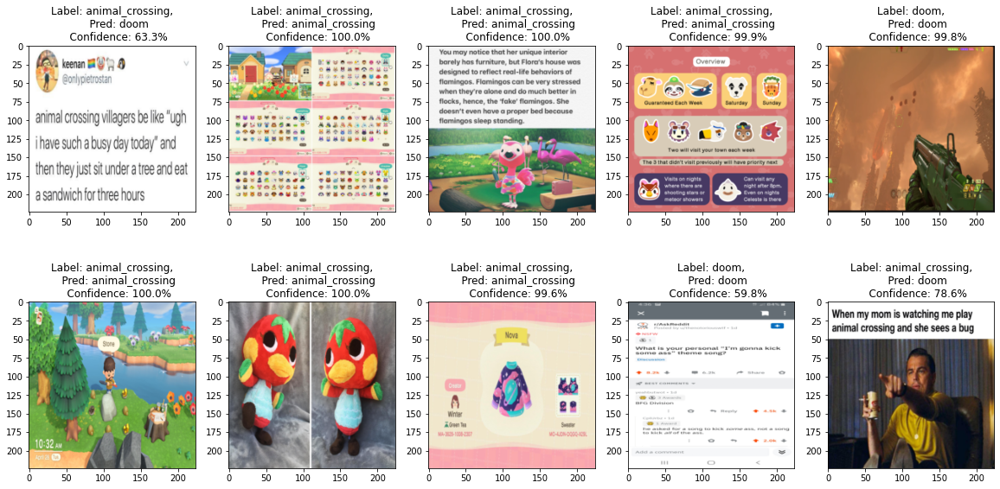

In [33]:
sample_idx = random.sample(range(len(val_ds)), 10)

plt.figure(figsize=(20,10))

for i, idx in enumerate(sample_idx):
    img, label = val_ds[idx]
    score = val_scores[idx]
    pred = val_preds[idx]

    plt.subplot(2,5,i+1)
    plt.imshow(img.numpy().transpose(1,2,0))
    
    title = f"""Label: {idx_to_class[label]},
    Pred: {idx_to_class[pred]}
    Confidence: {score[pred]*100:.1f}%"""

    plt.title(title)

Let's visualize only the wrong predictions

In [38]:
val_labels = [label for _, label in val_ds]

Number of wrong predictions: 41


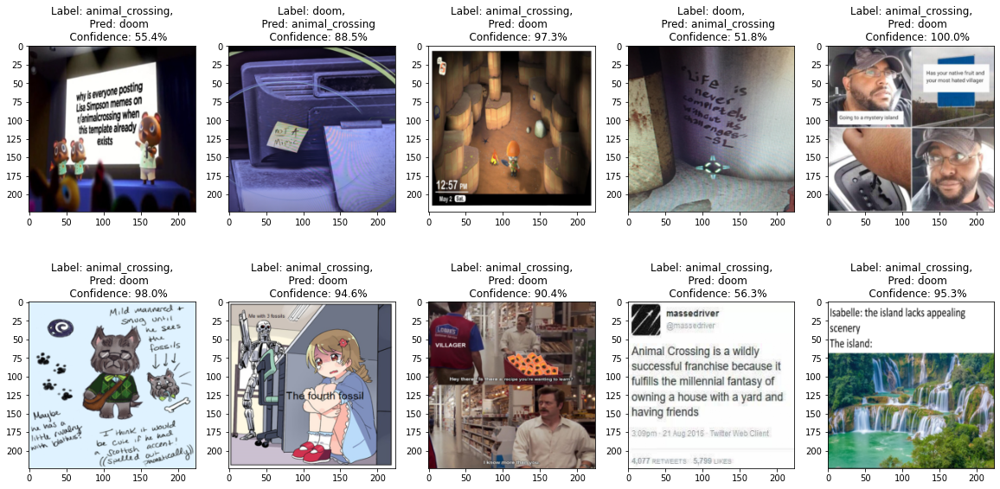

In [40]:
wrong_idx = [i for i, (pred, label) in enumerate(zip(val_preds, val_labels)) if pred != label]
sample_idx = random.sample(wrong_idx, 10)
print("Number of wrong predictions:", len(wrong_idx))

plt.figure(figsize=(20,10))

for i, idx in enumerate(sample_idx):
    img, label = val_ds[idx]
    score = val_scores[idx]
    pred = val_preds[idx]

    plt.subplot(2,5,i+1)
    plt.imshow(img.numpy().transpose(1,2,0))

    title = f"""Label: {idx_to_class[label]},
    Pred: {idx_to_class[pred]}
    Confidence: {score[pred]*100:.1f}%"""

    plt.title(title)

It is worrying that some wrong classifications have pretty **high confidence**.

From the results above, it can be seen that meme templates or **images with text** as the discriminating features for classification are the ones our model cannot classify correctly. This is an obvious limitation of the type of model we are using here.

We are implicitly focing CNN, a type of model that picks out visual features, to learn to **detect text, and meaning of text phrases/sentences**. Using a simple OCR to extract text from images and run a simple text-based model, such as RNN, should be more appropriate in this case.

Many of you can realize this and suggest a suitable solution.

Another observation is that **darker images** tend to be predicted as Doom. This might because Doom images are generally darker due to its artistic styles, but not always.

Training for longer epochs may help. Adding more **aggressive data augmentation** (like decreasing brightness for Animal Crossing and increasing brightness for Doom images) may help our model focus on more important features.

### 2. Does our model actually learn?

This question is about **interpretable Machine Learning**. 

Perhaps when trying not to give out too much hint, I did not phrase this question well. Many responses talked about validation loss, how validation loss also decreased with training loss. This only shows that the model **does not overfit**, but does not indicate whether the model **actually learns to recognize Animal Crossing or Doom**.

To illustrate this point, imagine this. Perhaps all Doom images are darker than Animal Crossing images (I don't check this, but it is a reasonable assumption). Maybe our model just looks at the overall brightness of an image to detect whether it is Animal Crossing or Doom. In a sense, it does not actually differentiate between Animal Crossing and Doom, but only look at other features that usually appear in one category but not another.

We need to define what it means for a model to "actually learn something". One simple way is to test whether the model looks at **salient, or discriminating features** of an image when it makes prediction.

One popular method is GradCAM. In essence, GradCAM finds which pixels would make the prediction more "correct".

Original GradCAM paper: https://arxiv.org/abs/1610.02391

Other methods: https://christophm.github.io/interpretable-ml-book/pixel-attribution.html


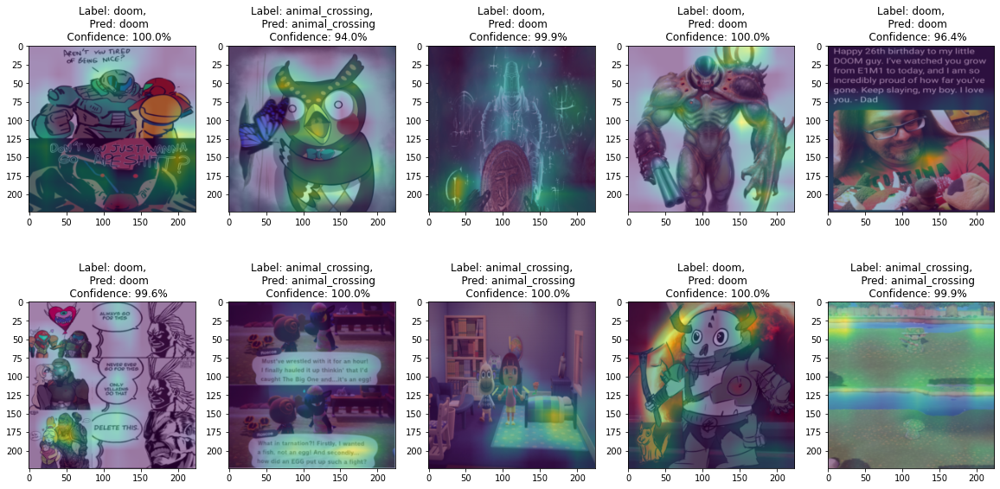

In [74]:
import numpy as np
import cv2

def grad_cam(img, pred):
    img_original = img.clone().numpy().transpose(1,2,0)

    img = img.unsqueeze(0).to(model.device)

    cnn_base = nn.Sequential(model.backbone.conv1, model.backbone.bn1, model.backbone.relu, model.backbone.layer1, model.backbone.layer2, model.backbone.layer3, model.backbone.layer4)
    avg_pool = model.backbone.avgpool
    classifier = model.backbone.fc

    last_feature_map = cnn_base(img)
    last_feature_map.retain_grad()

    pooled_feature_map = avg_pool(last_feature_map).view(1,-1)
    logits = classifier(pooled_feature_map)
    pred = logits.argmax(-1)[0].cpu().numpy()

    logits[0, pred].backward()

    gradients = last_feature_map.grad[0]
    pooled_gradients = gradients.mean(dim=[1,2])

    activations = last_feature_map.detach()[0]
    for i in range(activations.shape[0]):
        activations[i] *= pooled_gradients[i]

    heatmap = activations.sum(dim=0)
    heatmap = torch.relu(heatmap)
    heatmap = heatmap / heatmap.max()
    heatmap = heatmap.cpu().numpy()
    heatmap = cv2.resize(heatmap, (224,224), )

    cmap = plt.get_cmap("viridis")
    img_with_hm = img_original + cmap(heatmap)[...,:3]
    return img_with_hm / 2

sample_idx = random.sample(range(len(val_labels)), 10)

plt.figure(figsize=(20,10))

for i, idx in enumerate(sample_idx):
    img, label = val_ds[idx]
    score = val_scores[idx]
    pred = val_preds[idx]

    img = grad_cam(img, pred)

    plt.subplot(2,5,i+1)
    plt.imshow(img)
    
    title = f"""Label: {idx_to_class[label]},
    Pred: {idx_to_class[pred]}
    Confidence: {score[pred]*100:.1f}%"""

    plt.title(title)

For some photos, the model correctly focuses on **Doom and Animal Crossing characters**, which is also what we expect the model to learn. This can be an indication that our model has successfully learned the **discriminating features** between Doom and Animal Crossing.

However, for some photos, the model looks at text or background objects, which indicates the model is lucky at guessing those photos.

Let's use GradCAM for misclassifications

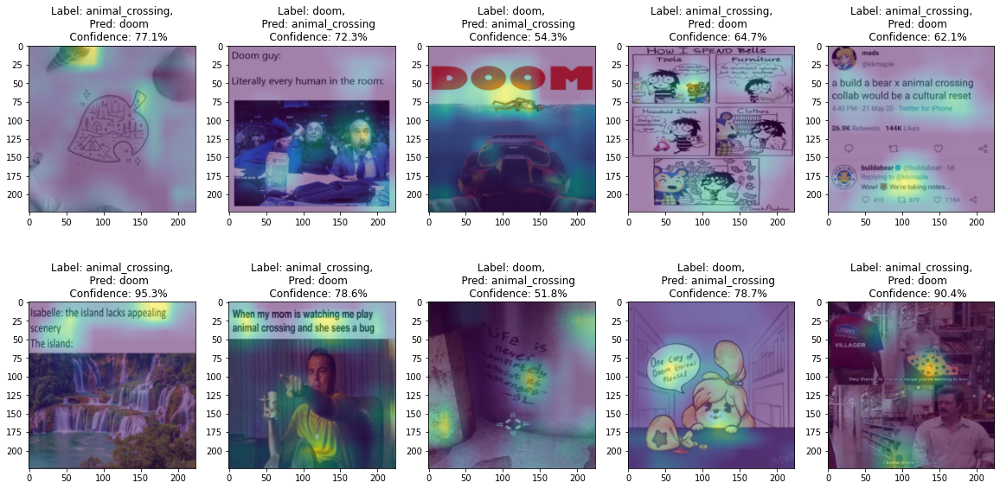

In [59]:
sample_idx = random.sample(wrong_idx, 10)

plt.figure(figsize=(20,10))

for i, idx in enumerate(sample_idx):
    img, label = val_ds[idx]
    score = val_scores[idx]
    pred = val_preds[idx]

    img = grad_cam(img, pred)

    plt.subplot(2,5,i+1)
    plt.imshow(img)
    
    title = f"""Label: {idx_to_class[label]},
    Pred: {idx_to_class[pred]}
    Confidence: {score[pred]*100:.1f}%"""

    plt.title(title)

GradCAM reveals why our model fails to classify some photos

- The model cannot recognize the word **Doom**. This is a limitation of CNN models as discussed above
- **Cartoonic** or **bright objects** tend to result in Animal Crossing predictions
- The model wrongly focuses on **unrelevant text**

### 3. Random photos: Out of distribution prediction

Let's predict a random photo

Prediction: doom
Confidence: 0.79036695


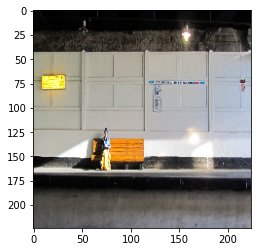

In [76]:
img_np = cv2.imread("sample.jpg")
img_np = cv2.cvtColor(img_np, cv2.COLOR_BGR2RGB)
img_np = cv2.resize(img_np, (224,224))

img = img_np.transpose(2,0,1).astype(np.float32) / 255
img = torch.from_numpy(img)

model.to("cpu")
img = img.unsqueeze(0)
with torch.no_grad():
    logits = model.backbone(img)[0]
    score = torch.softmax(logits, dim=-1).numpy()
    pred = torch.argmax(logits, dim=-1).numpy().item()

plt.imshow(img_np)
print("Prediction:", idx_to_class[pred])
print("Confidence:", score[pred])

The model is pretty confident that the image is Doom!

This problem is known as **Out-of-distribution prediction**. The model has never seen this kind of photo before, so we **can't guarantee** that it will make any sensible predictions.

Perhaps we can try GradCAM on this photo also?

Prediction: doom
Confidence: 0.79036695


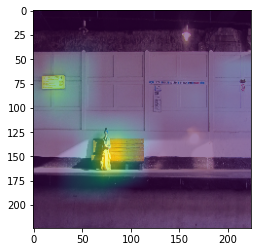

In [77]:
img = img_np.transpose(2,0,1).astype(np.float32) / 255
img = torch.from_numpy(img)

img = grad_cam(img, pred)

plt.imshow(img)
print("Prediction:", idx_to_class[pred])
print("Confidence:", score[pred])

The model looks at the sitting lady and the yellow sign. It's interesting that it correctly looks at **objects of interest** (not background) but it's puzzling how these objects would resemble Doom.

Many responses suggested using **thresholds** to classify an object as "neither-Doom-nor-Animal-Crossing" e.g. confidence < 0.3 will mean "neither" category. It's a reasonable approach, but clearly it will fail for the above photo.

Another commonly suggested solution is **adding a 3rd "neither" class** to the model. It's also a reasonable approach, but you will need **positive samples** for that class to successfully train the model.

My approach will be to change the problem to a **Multi-label classification**. It means that an image can have multiple labels, and each label is a binary classification problem. In this context, we will predict both **Doom or not Doom**, and **Animal Crossing or not Animal Crossing** at the same time.

Normal multi-class classification **forces the model to predict something**, even if it doesn't make sense. For multi-label classification, it's possible to **predict none of the classes**. Although this does not quite solve the problem of out-of-distribution, hopefully our model will be less confident at out-of-distribution samples.

In [99]:
class ImageClassifier_MultiLabel(ImageClassifier):
    def __init__(self, num_classes, loss_fn, learning_rate=1e-2):
        self.num_classes = num_classes
        super().__init__(num_classes, loss_fn, learning_rate)

    def label_to_onehot(self, label, dtype=torch.float32):
        one_hot = torch.zeros(label.shape + (self.num_classes,), device=self.device, dtype=dtype)
        label = label.cpu().numpy()
        for i, idx in enumerate(label):
            one_hot[i, idx] = 1
        return one_hot

    def training_step(self, batch, batch_idx):
        img, label = batch
        
        one_hot = self.label_to_onehot(label, dtype=img.dtype)
        logits = self.backbone(img)
        loss = self.loss_fn(logits, one_hot)

        self.log("train/loss", loss)
        return loss

    def validation_step(self, batch, batch_idx):
        img, label = batch

        one_hot = self.label_to_onehot(label, dtype=img.dtype)
        logits = self.backbone(img)
        
        loss = self.loss_fn(logits, one_hot)

        preds = torch.argmax(logits, dim=-1)
        acc = (label == preds).sum() / label.numel()
        
        self.log("val/loss", loss)
        self.log("val/acc", acc)

model = ImageClassifier_MultiLabel(2, nn.BCEWithLogitsLoss())

label = torch.tensor([1,0,1,0,0])
model.label_to_onehot(label)

tensor([[0., 1.],
        [1., 0.],
        [0., 1.],
        [1., 0.],
        [1., 0.]])

In [102]:
model = ImageClassifier_MultiLabel(2, nn.BCEWithLogitsLoss())

trainer = pl.Trainer(gpus=1, precision=16, max_epochs=10, log_every_n_steps=5, callbacks=[LearningRateMonitor()])

trainer.fit(model, train_dataloader, val_dataloader)

Using native 16bit precision.
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name     | Type              | Params
-----------------------------------------------
0 | backbone | ResNet            | 11.2 M
1 | loss_fn  | BCEWithLogitsLoss | 0     
-----------------------------------------------
11.2 M    Trainable params
0         Non-trainable params
11.2 M    Total params
44.710    Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

In [95]:
%tensorboard --logdir "lightning_logs"

<IPython.core.display.Javascript object>

This model achieves similar results as the previous model.

Confidence: 0.39441183 0.5967594


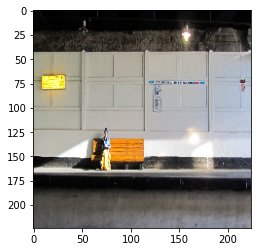

In [106]:
img_np = cv2.imread("sample.jpg")
img_np = cv2.cvtColor(img_np, cv2.COLOR_BGR2RGB)
img_np = cv2.resize(img_np, (224,224))

img = img_np.transpose(2,0,1).astype(np.float32) / 255
img = torch.from_numpy(img)

model.to("cpu")
img = img.unsqueeze(0)
with torch.no_grad():
    logits = model.backbone(img)[0]
    score = torch.sigmoid(logits).numpy()
    
plt.imshow(img_np)
print("Confidence:", *score)

If we choose a threshold of 0.5, our model sadly would still predict this as Doom. However, it is much **less confident** about its Doom prediction. Obviously, negative samples are still needed.

### 4. Add Genshin Impact memes

This is straight-forward. We simply need to use 3 output neurons insead of 2 for the last linear layer.

To avoid training from scratch, there are multiple ways:

- **Re-use Doom and Animal Crossing weights**. The model only needs to learn Genshin Impact.
- Use a pre-trained network as a **fixed feature extractor**. Then we can build a simple classification model (e.g. SVM, random forest, 2-layer MLP) to classify the image embeddings. (This approach discards all the previous work in this notebook, but it is more flexible when adding new classes)

Most of the responses can suggest reasonable solutions.